# Basic Version w/ Freeze Learning & Fine-tuning
For this approach, it will be used a pretrained DenseNet201, to which we will apply freeze learning and fine-tuning for our task.

In [1]:
import os

DATA_DIR = "../data/"
IMG_DIR = DATA_DIR + "/images/"
ANNOTATION_DIR = DATA_DIR + "/annotations/"
SPLITS_DIR = DATA_DIR + "/dl-split/"
OUT_DIR = "./out/basic_fine_tuned_experiment/"

os.makedirs(OUT_DIR, exist_ok=True)

SEED = 42

# Utility Function

In [2]:
import matplotlib.pyplot as plt
def plot_training_history(train_history, val_history, model_name, phase_name, out_dir):
    fig, (loss_ax, acc_ax) = plt.subplots(figsize=(12, 8), nrows=2)
    fig.suptitle(f"{model_name} - {phase_name} History")
    loss_ax.set_title("Cross Entropy Loss")
    loss_ax.plot(train_history["loss"], label="train")
    loss_ax.plot(val_history["loss"], label="val")
    loss_ax.legend(loc="best")

    acc_ax.set_title("Classification accuracy")
    acc_ax.plot(train_history["accuracy"], label="train")
    acc_ax.plot(val_history["accuracy"], label="val")
    loss_ax.legend(loc="best")

    plt.tight_layout()

    fig.savefig(f"{out_dir}/{model_name}_{phase_name}_history.png", dpi=150, bbox_inches='tight')

    return fig

## Load Dataset

In [3]:
# Fetching pre-defined splits
train_split = []
test_split = []

with open(SPLITS_DIR + "/train.txt") as train_split_f:
    train_split = [line.strip("\n") for line in train_split_f.readlines()]

with open(SPLITS_DIR + "/test.txt") as test_split_f:
    test_split = [line.strip("\n") for line in test_split_f.readlines()]

In [4]:
# Label mapping
label_encode_map = {
    "background": -100,
    "trafficlight": 0,
    "speedlimit": 1,
    "crosswalk": 2,
    "stop": 3,
}

label_decode_map = {
    -100: "background",
    0: "trafficlight",
    1: "speedlimit",
    2: "crosswalk",
    3: "stop",
}

# Cull training dataset to balance classes better

In [5]:
from utils.utils import parse_annotation

def get_annotations(split):
    annotations = {}
    for id in split:
        annotation = parse_annotation(f"{ANNOTATION_DIR}/{id}.xml", label_encode_map, return_biggest = True)
        annotation["labels"] = annotation["labels"][0]
        annotations[id] = annotation

    return annotations

annotations = get_annotations(train_split)

In [6]:
import pandas as pd
train_df = pd.DataFrame.from_dict(annotations, orient="index")
train_df

,width,height,labels,boxes,areas
road706,300.0,400.0,1,"[[135.0, 159.0, 177.0, 201.0]]",[1764.0]
road538,300.0,400.0,1,"[[115.0, 169.0, 149.0, 205.0]]",[1224.0]
road510,300.0,400.0,1,"[[89.0, 201.0, 133.0, 245.0]]",[1936.0]
road504,300.0,400.0,1,"[[92.0, 230.0, 139.0, 277.0]]",[2209.0]
road458,300.0,400.0,1,"[[67.0, 116.0, 139.0, 189.0]]",[5256.0]
...,...,...,...,...,...
road247,300.0,400.0,1,"[[139.0, 218.0, 156.0, 236.0]]",[306.0]
road253,300.0,400.0,1,"[[128.0, 87.0, 187.0, 144.0]]",[3363.0]
road535,300.0,400.0,1,"[[100.0, 254.0, 180.0, 334.0]]",[6400.0]
road284,300.0,400.0,1,"[[111.0, 133.0, 165.0, 187.0]]",[2916.0]


Label Ratios
0    0.086460
1    0.730832
2    0.104405
3    0.078303
Name: labels, dtype: float64


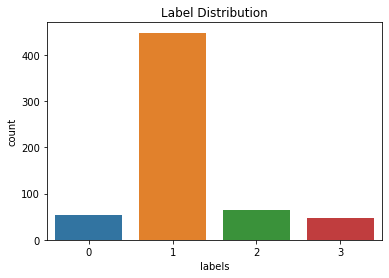

<Figure size 432x288 with 0 Axes>

In [7]:
import seaborn as sns
import matplotlib.pyplot as plt

print("Label Ratios")
label_ratios = (train_df["labels"].value_counts() / len(train_df["labels"])).sort_index()
print(label_ratios)

fig, ax = plt.subplots()
sns.countplot(data=train_df, x="labels", ax=ax, tick_label=["trafficlight", "speedlimit", "crosswalk", "stop"])
ax.set_title("Label Distribution")

plt.show()
plt.clf()

In [8]:
import numpy as np
non_max_labels = label_ratios[label_ratios != label_ratios.max()]
ratio_to_return = np.sum(non_max_labels) + np.max(non_max_labels) * 2

print(f"Ratio of training dataset to return: {ratio_to_return}")

Ratio of training dataset to return: 0.4779771615008157


In [9]:
label_ratios[1] /= 2
label_ratios

0    0.086460
1    0.365416
2    0.104405
3    0.078303
Name: labels, dtype: float64

In [10]:
weights = (1 - label_ratios) / np.sum(1 - label_ratios)
print("Weights")
print(weights)
train_df["weights"] = 0
for i, weight in enumerate(weights):
    train_df.loc[train_df["labels"] == i, "weights"] = weight / len(train_df[train_df["labels"] == i])

train_df

Weights
0    0.271449
1    0.188560
2    0.266117
3    0.273873
Name: labels, dtype: float64


,width,height,labels,boxes,areas,weights
road706,300.0,400.0,1,"[[135.0, 159.0, 177.0, 201.0]]",[1764.0],0.000421
road538,300.0,400.0,1,"[[115.0, 169.0, 149.0, 205.0]]",[1224.0],0.000421
road510,300.0,400.0,1,"[[89.0, 201.0, 133.0, 245.0]]",[1936.0],0.000421
road504,300.0,400.0,1,"[[92.0, 230.0, 139.0, 277.0]]",[2209.0],0.000421
road458,300.0,400.0,1,"[[67.0, 116.0, 139.0, 189.0]]",[5256.0],0.000421
...,...,...,...,...,...,...
road247,300.0,400.0,1,"[[139.0, 218.0, 156.0, 236.0]]",[306.0],0.000421
road253,300.0,400.0,1,"[[128.0, 87.0, 187.0, 144.0]]",[3363.0],0.000421
road535,300.0,400.0,1,"[[100.0, 254.0, 180.0, 334.0]]",[6400.0],0.000421
road284,300.0,400.0,1,"[[111.0, 133.0, 165.0, 187.0]]",[2916.0],0.000421


Label Ratios
0    0.180887
1    0.436860
2    0.218430
3    0.163823
Name: labels, dtype: float64


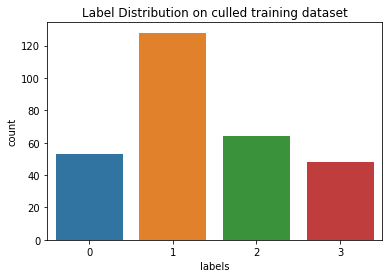

,width,height,labels,boxes,areas,weights
road164,300.0,400.0,0,"[[123.0, 132.0, 176.0, 202.0]]",[3710.0],0.005122
road278,300.0,400.0,0,"[[200.0, 252.0, 249.0, 322.0]]",[3430.0],0.005122
road582,300.0,400.0,0,"[[97.0, 124.0, 114.0, 168.0]]",[748.0],0.005122
road141,400.0,225.0,2,"[[147.0, 74.0, 244.0, 163.0]]",[8633.0],0.004158
road676,300.0,400.0,3,"[[155.0, 151.0, 193.0, 190.0]]",[1482.0],0.005706
...,...,...,...,...,...,...
road642,300.0,400.0,1,"[[97.0, 178.0, 177.0, 257.0]]",[6320.0],0.000421
road384,300.0,400.0,1,"[[107.0, 160.0, 145.0, 197.0]]",[1406.0],0.000421
road423,300.0,400.0,1,"[[101.0, 180.0, 141.0, 219.0]]",[1560.0],0.000421
road397,300.0,400.0,1,"[[128.0, 55.0, 222.0, 148.0]]",[8742.0],0.000421


<Figure size 432x288 with 0 Axes>

In [11]:
culled_df = train_df.sample(frac=ratio_to_return, weights="weights", random_state=SEED)
print("Label Ratios")
label_ratios = (culled_df["labels"].value_counts() / len(culled_df["labels"])).sort_index()
print(label_ratios)

fig, ax = plt.subplots()
sns.countplot(data=culled_df, x="labels", ax=ax, tick_label=["trafficlight", "speedlimit", "crosswalk", "stop"])
ax.set_title("Label Distribution on culled training dataset")

plt.show()
plt.clf()

culled_df

Train Label Ratios
1    0.437768
2    0.218884
0    0.180258
3    0.163090
Name: labels, dtype: float64
Validation Label Ratios
1    0.433333
2    0.216667
0    0.183333
3    0.166667
Name: labels, dtype: float64


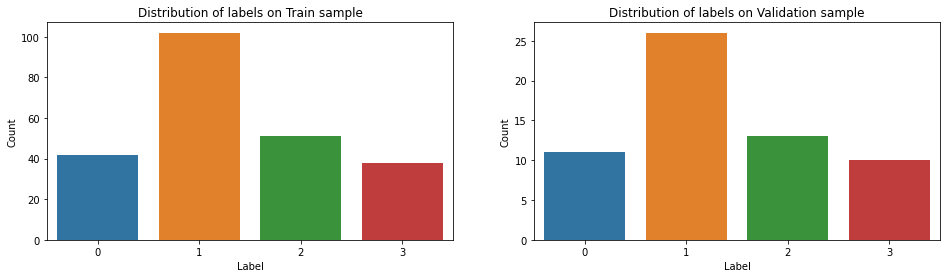

<Figure size 432x288 with 0 Axes>

In [12]:
# Maintain the ratios of labels across splits
import numpy as np

train_sample = culled_df.groupby("labels").sample(frac=0.8, random_state=SEED)
val_sample = culled_df.loc[culled_df.index.difference(train_sample.index)]

fig, (train_ax, val_ax) = plt.subplots(figsize=(16, 4), ncols=2)
for split, df, ax in zip(["Train", "Validation"], [train_sample, val_sample], [train_ax, val_ax]):
    sns.countplot(x=df["labels"], ax=ax)
    ax.set_title(f"Distribution of labels on {split} sample")
    ax.set_xlabel("Label")
    ax.set_ylabel("Count")
    
    print(f"{split} Label Ratios")
    print(pd.Series(df["labels"]).value_counts() / len(df["labels"]))
plt.show()
plt.clf()

In [13]:
from datasets.road_sign_dataset import RoadSignDataset

# Training dataset
training_data = RoadSignDataset(
    img_names=train_sample.index.tolist(),
    img_dir=IMG_DIR,
    annotation_dir=ANNOTATION_DIR,
    classes=label_encode_map,
    is_train=True,
    multilabel=False
)

# Validation dataset
validation_data = RoadSignDataset(
    img_names=val_sample.index.tolist(),
    img_dir=IMG_DIR,
    annotation_dir=ANNOTATION_DIR,
    classes=label_encode_map,
    is_train=True,
    multilabel=False
)

# Test dataset
testing_data = RoadSignDataset(
    img_names=test_split,
    img_dir=IMG_DIR,
    annotation_dir=ANNOTATION_DIR,
    classes=label_encode_map,
    is_train=False,
    multilabel=False,
)

# Create Dataloaders

In [14]:
from torch.utils.data import DataLoader

BATCH_SIZE = 8 # Tested on 1050TI with 4GB (can load at least 64 as well, but doesn't make sense to use 64 with low amount of data)
NUM_WORKERS = 4

train_dataloader = DataLoader(
    dataset=training_data,
    #sampler=train_sampler,
    batch_size=BATCH_SIZE,
    num_workers=NUM_WORKERS,
    shuffle=True, # Must be False because we're using a random sampler already
    drop_last=True,
    collate_fn=training_data.collate_fn
)

val_dataloader = DataLoader(
    dataset=validation_data,
    #sampler=val_sampler,
    batch_size=BATCH_SIZE,
    num_workers=NUM_WORKERS,
    shuffle=True, # Must be False because we're using a random sampler already
    drop_last=True,
    collate_fn=training_data.collate_fn
)

test_dataloader = DataLoader(
    dataset=testing_data,
    batch_size=1,
    num_workers=NUM_WORKERS,
    shuffle=False,
    drop_last=False,
    collate_fn=testing_data.collate_fn
)

# Model Definition

In [15]:
from torchvision import models
from torch import nn
from torchinfo import summary

MODEL_NAME = "BASIC_FINE_TUNED"
N_CLASSES = 4

def get_model(n_classes):
    model = models.densenet201(pretrained=True)
    in_features = model.classifier.in_features
    model.classifier = nn.Linear(
        in_features=in_features,
        out_features=n_classes,
        bias=True
    )

    return model

model = get_model(n_classes=N_CLASSES)

summary(model)

Layer (type:depth-idx)                   Param #
DenseNet                                 --
├─Sequential: 1-1                        --
│    └─Conv2d: 2-1                       9,408
│    └─BatchNorm2d: 2-2                  128
│    └─ReLU: 2-3                         --
│    └─MaxPool2d: 2-4                    --
│    └─_DenseBlock: 2-5                  --
│    │    └─_DenseLayer: 3-1             45,440
│    │    └─_DenseLayer: 3-2             49,600
│    │    └─_DenseLayer: 3-3             53,760
│    │    └─_DenseLayer: 3-4             57,920
│    │    └─_DenseLayer: 3-5             62,080
│    │    └─_DenseLayer: 3-6             66,240
│    └─_Transition: 2-6                  --
│    │    └─BatchNorm2d: 3-7             512
│    │    └─ReLU: 3-8                    --
│    │    └─Conv2d: 3-9                  32,768
│    │    └─AvgPool2d: 3-10              --
│    └─_DenseBlock: 2-7                  --
│    │    └─_DenseLayer: 3-11            53,760
│    │    └─_DenseLayer: 3-12     

# Define Optimizer, LR Scheduler, Loss function and Metric Scorer

In [16]:
from torch import optim
import torchmetrics

optimizer = optim.Adam(
    params=model.parameters(),
    lr=5e-3,
    betas=(0.9, 0.999),
    weight_decay=5e-4,
    amsgrad=True
)

lr_scheduler = optim.lr_scheduler.ExponentialLR(
    optimizer=optimizer,
    gamma=0.95,
    verbose=True
)

loss_fn = nn.CrossEntropyLoss(ignore_index=label_encode_map["background"])

metric_scorer = torchmetrics.Accuracy(
    threshold=0.5,
    num_classes=N_CLASSES,
    average="micro",
    ignore_index=label_encode_map["background"]
)

Adjusting learning rate of group 0 to 5.0000e-03.


# Define Epoch Iteration

In [17]:
import torch
import torch.nn.functional as F
from tqdm import tqdm

def epoch_iter(dataloader, model, loss_fn, device, is_train = True, optimizer=None, lr_scheduler=None):
    if is_train:
        assert optimizer is not None, "When training, please provide an optimizer."
      
    num_batches = len(dataloader)

    if is_train:
        model.train()
    else:
        model.eval()

    probs = []
    preds = []
    expected_labels = []
    imageIds = []

    total_loss = 0.0

    with torch.set_grad_enabled(is_train):
        for _batch, (X, y) in enumerate(tqdm(dataloader)):
            labels = y["labels"]
            ids = y["imageIds"]

            X, y = X.to(device), labels.to(device)

            pred = model(X)
            loss = loss_fn(pred, y)

            if is_train:
                optimizer.zero_grad()
                loss.backward()
                optimizer.step()
            
            total_loss += loss.item()

            prob = F.softmax(pred, dim=1)
            final_pred = torch.argmax(prob, dim=1)

            probs.extend(prob.detach().cpu().numpy())
            preds.extend(final_pred.detach().cpu().numpy())
            expected_labels.extend(y.detach().cpu().numpy())
            imageIds.extend([f"road{imageId}" for imageId in ids.detach().cpu().numpy()])

        if is_train and lr_scheduler is not None:
            lr_scheduler.step()
    

    return (expected_labels, preds, probs, imageIds), total_loss / num_batches

# Train Model

In [18]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

print(f"Using device: {device}")

Using device: cuda:0


In [19]:
NUM_EPOCHS = 30

model.to(device)
model.features.requires_grad_(False) # Freeze feature layer

train_history = {
    "loss": [],
    "accuracy": [],
}

val_history = {
    "loss": [],
    "accuracy": [],
}

best_val_loss = np.inf
best_val_accuracy = 0
best_epoch = -1

print(f"Starting {MODEL_NAME} training...")

for epoch in range(1, NUM_EPOCHS + 1):
    print(f"Epoch[{epoch}/{NUM_EPOCHS}]")
    (train_target, train_preds, train_probs, _), train_loss = epoch_iter(
        dataloader=train_dataloader,
        model=model,
        loss_fn=loss_fn,
        device=device,
        is_train=True,
        optimizer=optimizer,
        lr_scheduler=lr_scheduler
    )

    train_accuracy = metric_scorer(torch.tensor(np.array(train_probs)), torch.tensor(np.array(train_target))).item()
    print(f"Training loss: {train_loss:.3f}\t Training micro accuracy: {train_accuracy:.3f}")

    (val_target, val_preds, val_probs, _), val_loss = epoch_iter(
        dataloader=val_dataloader,
        model=model,
        loss_fn=loss_fn,
        device=device,
        is_train=False,
    )

    val_accuracy = metric_scorer(torch.tensor(np.array(val_probs)), torch.tensor(np.array(val_target))).item()
    print(f"Validation loss: {val_loss:.3f}\t Validation micro accuracy: {val_accuracy:.3f}")

    # Save best model
    if val_loss < best_val_loss:
        best_val_loss = val_loss
        best_val_accuracy = val_accuracy
        best_epoch = epoch
        save_dict = {"model": model.state_dict(), "optimizer": optimizer.state_dict(), "lr_scheduler": lr_scheduler.state_dict(), "epoch": epoch}
        torch.save(save_dict, f"{OUT_DIR}/{MODEL_NAME}_best_model.pth")

    # Save latest model
    save_dict = {"model": model.state_dict(), "optimizer": optimizer.state_dict(), "lr_scheduler": lr_scheduler.state_dict(), "epoch": epoch}
    torch.save(save_dict, f"{OUT_DIR}/{MODEL_NAME}_latest_model.pth")

    # Save loss and accuracy in history
    train_history["loss"].append(train_loss)
    train_history["accuracy"].append(train_accuracy)

    val_history["loss"].append(val_loss)
    val_history["accuracy"].append(val_accuracy)

    print("----------------------------------------------------------------")

print(
    f"\nFinished training..."
    f"\nBest epoch: {best_epoch}\t Validation loss on best epoch: {best_val_loss}\t Accuracy on best epoch: {best_val_accuracy}"
)

Starting BASIC_FINE_TUNED training...
Epoch[1/30]


100%|██████████| 29/29 [00:09<00:00,  3.21it/s]


Adjusting learning rate of group 0 to 4.7500e-03.
Training loss: 1.256	 Training micro accuracy: 0.531


100%|██████████| 7/7 [00:03<00:00,  1.96it/s]


Validation loss: 0.656	 Validation micro accuracy: 0.808
----------------------------------------------------------------
Epoch[2/30]


100%|██████████| 29/29 [00:06<00:00,  4.21it/s]


Adjusting learning rate of group 0 to 4.5125e-03.
Training loss: 0.768	 Training micro accuracy: 0.748


100%|██████████| 7/7 [00:03<00:00,  1.86it/s]


Validation loss: 0.475	 Validation micro accuracy: 0.843
----------------------------------------------------------------
Epoch[3/30]


100%|██████████| 29/29 [00:07<00:00,  4.04it/s]


Adjusting learning rate of group 0 to 4.2869e-03.
Training loss: 0.553	 Training micro accuracy: 0.806


100%|██████████| 7/7 [00:03<00:00,  1.88it/s]


Validation loss: 0.530	 Validation micro accuracy: 0.788
----------------------------------------------------------------
Epoch[4/30]


100%|██████████| 29/29 [00:07<00:00,  4.13it/s]


Adjusting learning rate of group 0 to 4.0725e-03.
Training loss: 0.471	 Training micro accuracy: 0.814


100%|██████████| 7/7 [00:03<00:00,  1.81it/s]


Validation loss: 0.468	 Validation micro accuracy: 0.811
----------------------------------------------------------------
Epoch[5/30]


100%|██████████| 29/29 [00:07<00:00,  3.92it/s]


Adjusting learning rate of group 0 to 3.8689e-03.
Training loss: 0.445	 Training micro accuracy: 0.837


100%|██████████| 7/7 [00:04<00:00,  1.64it/s]


Validation loss: 0.514	 Validation micro accuracy: 0.865
----------------------------------------------------------------
Epoch[6/30]


100%|██████████| 29/29 [00:07<00:00,  3.88it/s]


Adjusting learning rate of group 0 to 3.6755e-03.
Training loss: 0.525	 Training micro accuracy: 0.775


100%|██████████| 7/7 [00:04<00:00,  1.74it/s]


Validation loss: 0.487	 Validation micro accuracy: 0.843
----------------------------------------------------------------
Epoch[7/30]


100%|██████████| 29/29 [00:06<00:00,  4.17it/s]


Adjusting learning rate of group 0 to 3.4917e-03.
Training loss: 0.440	 Training micro accuracy: 0.870


100%|██████████| 7/7 [00:04<00:00,  1.69it/s]


Validation loss: 0.371	 Validation micro accuracy: 0.891
----------------------------------------------------------------
Epoch[8/30]


100%|██████████| 29/29 [00:07<00:00,  4.05it/s]


Adjusting learning rate of group 0 to 3.3171e-03.
Training loss: 0.341	 Training micro accuracy: 0.903


100%|██████████| 7/7 [00:04<00:00,  1.65it/s]


Validation loss: 0.505	 Validation micro accuracy: 0.788
----------------------------------------------------------------
Epoch[9/30]


100%|██████████| 29/29 [00:07<00:00,  3.86it/s]


Adjusting learning rate of group 0 to 3.1512e-03.
Training loss: 0.382	 Training micro accuracy: 0.862


100%|██████████| 7/7 [00:05<00:00,  1.18it/s]


Validation loss: 0.396	 Validation micro accuracy: 0.830
----------------------------------------------------------------
Epoch[10/30]


100%|██████████| 29/29 [00:08<00:00,  3.31it/s]


Adjusting learning rate of group 0 to 2.9937e-03.
Training loss: 0.400	 Training micro accuracy: 0.854


100%|██████████| 7/7 [00:05<00:00,  1.25it/s]


Validation loss: 0.605	 Validation micro accuracy: 0.827
----------------------------------------------------------------
Epoch[11/30]


100%|██████████| 29/29 [00:08<00:00,  3.41it/s]


Adjusting learning rate of group 0 to 2.8440e-03.
Training loss: 0.454	 Training micro accuracy: 0.848


100%|██████████| 7/7 [00:05<00:00,  1.32it/s]


Validation loss: 0.577	 Validation micro accuracy: 0.827
----------------------------------------------------------------
Epoch[12/30]


100%|██████████| 29/29 [00:08<00:00,  3.61it/s]


Adjusting learning rate of group 0 to 2.7018e-03.
Training loss: 0.543	 Training micro accuracy: 0.832


100%|██████████| 7/7 [00:04<00:00,  1.50it/s]


Validation loss: 0.375	 Validation micro accuracy: 0.863
----------------------------------------------------------------
Epoch[13/30]


100%|██████████| 29/29 [00:08<00:00,  3.44it/s]


Adjusting learning rate of group 0 to 2.5667e-03.
Training loss: 0.488	 Training micro accuracy: 0.837


100%|██████████| 7/7 [00:06<00:00,  1.17it/s]


Validation loss: 0.512	 Validation micro accuracy: 0.818
----------------------------------------------------------------
Epoch[14/30]


100%|██████████| 29/29 [00:08<00:00,  3.50it/s]


Adjusting learning rate of group 0 to 2.4384e-03.
Training loss: 0.444	 Training micro accuracy: 0.846


100%|██████████| 7/7 [00:04<00:00,  1.63it/s]


Validation loss: 0.394	 Validation micro accuracy: 0.902
----------------------------------------------------------------
Epoch[15/30]


100%|██████████| 29/29 [00:07<00:00,  3.92it/s]


Adjusting learning rate of group 0 to 2.3165e-03.
Training loss: 0.293	 Training micro accuracy: 0.885


100%|██████████| 7/7 [00:05<00:00,  1.17it/s]


Validation loss: 0.581	 Validation micro accuracy: 0.811
----------------------------------------------------------------
Epoch[16/30]


100%|██████████| 29/29 [00:07<00:00,  3.92it/s]


Adjusting learning rate of group 0 to 2.2006e-03.
Training loss: 0.453	 Training micro accuracy: 0.875


100%|██████████| 7/7 [00:04<00:00,  1.51it/s]


Validation loss: 0.438	 Validation micro accuracy: 0.904
----------------------------------------------------------------
Epoch[17/30]


100%|██████████| 29/29 [00:09<00:00,  3.21it/s]


Adjusting learning rate of group 0 to 2.0906e-03.
Training loss: 0.408	 Training micro accuracy: 0.871


100%|██████████| 7/7 [00:04<00:00,  1.43it/s]


Validation loss: 0.530	 Validation micro accuracy: 0.796
----------------------------------------------------------------
Epoch[18/30]


100%|██████████| 29/29 [00:07<00:00,  3.66it/s]


Adjusting learning rate of group 0 to 1.9861e-03.
Training loss: 0.387	 Training micro accuracy: 0.886


100%|██████████| 7/7 [00:03<00:00,  1.86it/s]


Validation loss: 0.479	 Validation micro accuracy: 0.849
----------------------------------------------------------------
Epoch[19/30]


100%|██████████| 29/29 [00:07<00:00,  3.92it/s]


Adjusting learning rate of group 0 to 1.8868e-03.
Training loss: 0.452	 Training micro accuracy: 0.847


100%|██████████| 7/7 [00:04<00:00,  1.48it/s]


Validation loss: 0.624	 Validation micro accuracy: 0.808
----------------------------------------------------------------
Epoch[20/30]


100%|██████████| 29/29 [00:07<00:00,  3.89it/s]


Adjusting learning rate of group 0 to 1.7924e-03.
Training loss: 0.355	 Training micro accuracy: 0.900


100%|██████████| 7/7 [00:04<00:00,  1.46it/s]


Validation loss: 0.671	 Validation micro accuracy: 0.792
----------------------------------------------------------------
Epoch[21/30]


100%|██████████| 29/29 [00:07<00:00,  3.83it/s]


Adjusting learning rate of group 0 to 1.7028e-03.
Training loss: 0.328	 Training micro accuracy: 0.902


100%|██████████| 7/7 [00:04<00:00,  1.74it/s]


Validation loss: 0.483	 Validation micro accuracy: 0.846
----------------------------------------------------------------
Epoch[22/30]


100%|██████████| 29/29 [00:07<00:00,  3.97it/s]


Adjusting learning rate of group 0 to 1.6177e-03.
Training loss: 0.371	 Training micro accuracy: 0.871


100%|██████████| 7/7 [00:04<00:00,  1.42it/s]


Validation loss: 0.473	 Validation micro accuracy: 0.839
----------------------------------------------------------------
Epoch[23/30]


100%|██████████| 29/29 [00:08<00:00,  3.58it/s]


Adjusting learning rate of group 0 to 1.5368e-03.
Training loss: 0.353	 Training micro accuracy: 0.881


100%|██████████| 7/7 [00:04<00:00,  1.51it/s]


Validation loss: 0.411	 Validation micro accuracy: 0.860
----------------------------------------------------------------
Epoch[24/30]


100%|██████████| 29/29 [00:07<00:00,  3.75it/s]


Adjusting learning rate of group 0 to 1.4599e-03.
Training loss: 0.342	 Training micro accuracy: 0.857


100%|██████████| 7/7 [00:04<00:00,  1.50it/s]


Validation loss: 0.431	 Validation micro accuracy: 0.836
----------------------------------------------------------------
Epoch[25/30]


100%|██████████| 29/29 [00:07<00:00,  3.69it/s]


Adjusting learning rate of group 0 to 1.3869e-03.
Training loss: 0.302	 Training micro accuracy: 0.883


100%|██████████| 7/7 [00:04<00:00,  1.51it/s]


Validation loss: 0.467	 Validation micro accuracy: 0.839
----------------------------------------------------------------
Epoch[26/30]


100%|██████████| 29/29 [00:07<00:00,  3.70it/s]


Adjusting learning rate of group 0 to 1.3176e-03.
Training loss: 0.296	 Training micro accuracy: 0.903


100%|██████████| 7/7 [00:04<00:00,  1.51it/s]


Validation loss: 0.385	 Validation micro accuracy: 0.880
----------------------------------------------------------------
Epoch[27/30]


100%|██████████| 29/29 [00:07<00:00,  3.74it/s]


Adjusting learning rate of group 0 to 1.2517e-03.
Training loss: 0.243	 Training micro accuracy: 0.919


100%|██████████| 7/7 [00:04<00:00,  1.50it/s]


Validation loss: 0.567	 Validation micro accuracy: 0.846
----------------------------------------------------------------
Epoch[28/30]


100%|██████████| 29/29 [00:07<00:00,  3.75it/s]


Adjusting learning rate of group 0 to 1.1891e-03.
Training loss: 0.224	 Training micro accuracy: 0.922


100%|██████████| 7/7 [00:04<00:00,  1.50it/s]


Validation loss: 0.540	 Validation micro accuracy: 0.827
----------------------------------------------------------------
Epoch[29/30]


100%|██████████| 29/29 [00:07<00:00,  3.68it/s]


Adjusting learning rate of group 0 to 1.1297e-03.
Training loss: 0.315	 Training micro accuracy: 0.876


100%|██████████| 7/7 [00:04<00:00,  1.45it/s]


Validation loss: 0.366	 Validation micro accuracy: 0.915
----------------------------------------------------------------
Epoch[30/30]


100%|██████████| 29/29 [00:07<00:00,  3.67it/s]


Adjusting learning rate of group 0 to 1.0732e-03.
Training loss: 0.253	 Training micro accuracy: 0.910


100%|██████████| 7/7 [00:05<00:00,  1.32it/s]


Validation loss: 0.501	 Validation micro accuracy: 0.824
----------------------------------------------------------------

Finished training...
Best epoch: 29	 Validation loss on best epoch: 0.3657908524785723	 Accuracy on best epoch: 0.914893627166748


C:\Users\telmo\AppData\Local\Temp/ipykernel_6776/3610660889.py:2: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  fig.show()


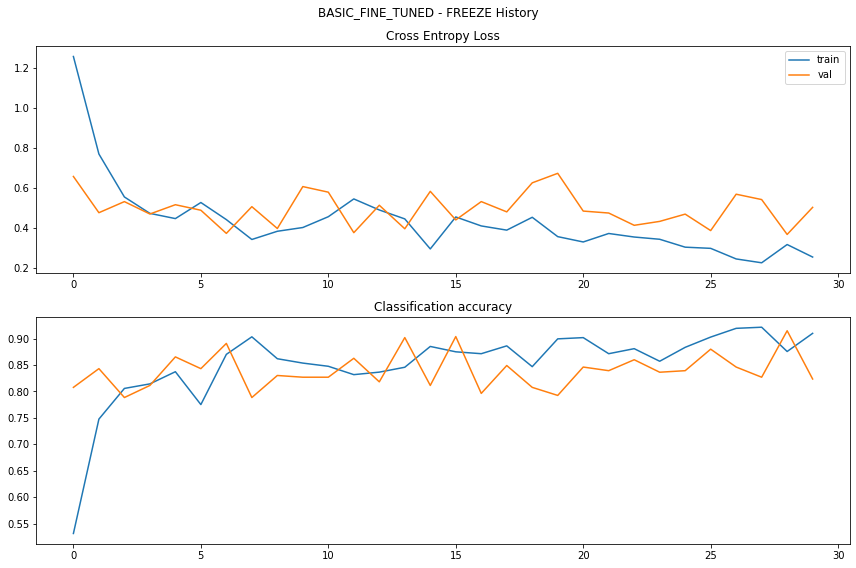

In [20]:
fig = plot_training_history(train_history=train_history, val_history=val_history, model_name=MODEL_NAME, phase_name="FREEZE", out_dir=OUT_DIR)
fig.show()

Clear GPU memory for guarantees

In [21]:
import gc
model = None

gc.collect()
torch.cuda.empty_cache()
torch.cuda.mem_get_info(device)

(2877462939, 4294836224)

In [22]:
!nvidia-smi

Fri Jun 10 15:24:44 2022       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 512.95       Driver Version: 512.95       CUDA Version: 11.6     |
|-------------------------------+----------------------+----------------------+
| GPU  Name            TCC/WDDM | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  NVIDIA GeForce ... WDDM  | 00000000:01:00.0 Off |                  N/A |
| N/A   63C    P8    N/A /  N/A |    674MiB /  4096MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

# Fine-tune the model

Load best model from first training session

In [23]:
BATCH_SIZE = 8 # Have to reduce batch size otherwise GPU memory dies (tested on 1050TI with 4GB)

train_dataloader = DataLoader(
    dataset=training_data,
    #sampler=train_sampler,
    batch_size=BATCH_SIZE,
    num_workers=NUM_WORKERS,
    shuffle=True,
    drop_last=True,
    collate_fn=training_data.collate_fn
)

val_dataloader = DataLoader(
    dataset=validation_data,
    #sampler=val_sampler,
    batch_size=BATCH_SIZE,
    num_workers=NUM_WORKERS,
    shuffle=True, # Must be False because we're using a random sampler already
    drop_last=True,
    collate_fn=training_data.collate_fn
)

In [24]:
best_checkpoint = torch.load(f"{OUT_DIR}/{MODEL_NAME}_best_model.pth")
model = get_model(n_classes=N_CLASSES)
model.load_state_dict(best_checkpoint["model"])
best_checkpoint = None

model.to(device)


print("Loaded best model...")

Loaded best model...


In [25]:
ft_optimizer = optim.Adam(
    params=model.parameters(),
    lr=1e-5,
    betas=(0.9, 0.999),
    weight_decay=5e-4,
    amsgrad=True
)

ft_lr_scheduler = optim.lr_scheduler.ExponentialLR(
    optimizer=ft_optimizer,
    gamma=0.9
)

In [26]:
FT_NUM_EPOCHS = 15
model.features.requires_grad_(True) # Unfreeze feature layer for fine-tuning

ft_train_history = {
    "loss": [],
    "accuracy": [],
}

ft_val_history = {
    "loss": [],
    "accuracy": [],
}

ft_best_val_loss = best_val_loss
ft_best_val_accuracy = best_val_accuracy
ft_best_epoch = -1

print(f"Starting {MODEL_NAME} fine-tuning...")

for epoch in range(1, FT_NUM_EPOCHS + 1):
    print(f"Epoch[{epoch}/{FT_NUM_EPOCHS}]")
    (train_target, train_preds, train_probs, _), train_loss = epoch_iter(
        dataloader=train_dataloader,
        model=model,
        loss_fn=loss_fn,
        device=device,
        is_train=True,
        optimizer=ft_optimizer,
        lr_scheduler=ft_lr_scheduler
    )

    train_accuracy = metric_scorer(torch.tensor(np.array(train_probs)), torch.tensor(np.array(train_target))).item()
    print(f"Training loss: {train_loss:.3f}\t Training micro accuracy: {train_accuracy:.3f}")

    (val_target, val_preds, val_probs, _), val_loss = epoch_iter(
        dataloader=val_dataloader,
        model=model,
        loss_fn=loss_fn,
        device=device,
        is_train=False,
    )

    val_accuracy = metric_scorer(torch.tensor(np.array(val_probs)), torch.tensor(np.array(val_target))).item()
    print(f"Validation loss: {val_loss:.3f}\t Validation micro accuracy: {val_accuracy:.3f}")

    # Save best model
    if val_loss < ft_best_val_loss:
        ft_best_val_loss = val_loss
        ft_best_val_accuracy = val_accuracy
        ft_best_epoch = epoch
        save_dict = {"model": model.state_dict(), "optimizer": ft_optimizer.state_dict(), "lr_scheduler": ft_lr_scheduler.state_dict(), "epoch": epoch}
        torch.save(save_dict, f"{OUT_DIR}/{MODEL_NAME}_ft_best_model.pth")

    # Save latest model
    save_dict = {"model": model.state_dict(), "optimizer": ft_optimizer.state_dict(), "lr_scheduler": ft_lr_scheduler.state_dict(), "epoch": epoch}
    torch.save(save_dict, f"{OUT_DIR}/{MODEL_NAME}_ft_latest_model.pth")

    # Save loss and accuracy in history
    ft_train_history["loss"].append(train_loss)
    ft_train_history["accuracy"].append(train_accuracy)

    ft_val_history["loss"].append(val_loss)
    ft_val_history["accuracy"].append(val_accuracy)

    print("----------------------------------------------------------------")

print(
    f"\nFinished fine-tuning..."
    f"\nBest epoch: {ft_best_epoch}\t Validation loss on best epoch: {ft_best_val_loss}\t Accuracy on best epoch: {ft_best_val_accuracy}"
)

Starting BASIC_FINE_TUNED fine-tuning...
Epoch[1/15]


100%|██████████| 29/29 [00:15<00:00,  1.93it/s]


Training loss: 0.258	 Training micro accuracy: 0.895


100%|██████████| 7/7 [00:03<00:00,  1.81it/s]


Validation loss: 0.384	 Validation micro accuracy: 0.926
----------------------------------------------------------------
Epoch[2/15]


100%|██████████| 29/29 [00:15<00:00,  1.92it/s]


Training loss: 0.271	 Training micro accuracy: 0.909


100%|██████████| 7/7 [00:05<00:00,  1.33it/s]


Validation loss: 0.219	 Validation micro accuracy: 0.900
----------------------------------------------------------------
Epoch[3/15]


100%|██████████| 29/29 [00:15<00:00,  1.92it/s]


Training loss: 0.241	 Training micro accuracy: 0.926


100%|██████████| 7/7 [00:03<00:00,  1.83it/s]


Validation loss: 0.528	 Validation micro accuracy: 0.840
----------------------------------------------------------------
Epoch[4/15]


100%|██████████| 29/29 [00:15<00:00,  1.85it/s]


Training loss: 0.189	 Training micro accuracy: 0.928


100%|██████████| 7/7 [00:05<00:00,  1.24it/s]


Validation loss: 0.437	 Validation micro accuracy: 0.865
----------------------------------------------------------------
Epoch[5/15]


100%|██████████| 29/29 [00:21<00:00,  1.37it/s]


Training loss: 0.194	 Training micro accuracy: 0.929


100%|██████████| 7/7 [00:04<00:00,  1.50it/s]


Validation loss: 0.440	 Validation micro accuracy: 0.788
----------------------------------------------------------------
Epoch[6/15]


100%|██████████| 29/29 [00:15<00:00,  1.88it/s]


Training loss: 0.198	 Training micro accuracy: 0.921


100%|██████████| 7/7 [00:04<00:00,  1.60it/s]


Validation loss: 0.524	 Validation micro accuracy: 0.849
----------------------------------------------------------------
Epoch[7/15]


100%|██████████| 29/29 [00:17<00:00,  1.67it/s]


Training loss: 0.227	 Training micro accuracy: 0.928


100%|██████████| 7/7 [00:05<00:00,  1.34it/s]


Validation loss: 0.562	 Validation micro accuracy: 0.865
----------------------------------------------------------------
Epoch[8/15]


100%|██████████| 29/29 [00:15<00:00,  1.85it/s]


Training loss: 0.184	 Training micro accuracy: 0.967


100%|██████████| 7/7 [00:03<00:00,  1.87it/s]


Validation loss: 0.445	 Validation micro accuracy: 0.889
----------------------------------------------------------------
Epoch[9/15]


100%|██████████| 29/29 [00:15<00:00,  1.91it/s]


Training loss: 0.219	 Training micro accuracy: 0.919


100%|██████████| 7/7 [00:07<00:00,  1.12s/it]


Validation loss: 0.320	 Validation micro accuracy: 0.863
----------------------------------------------------------------
Epoch[10/15]


100%|██████████| 29/29 [00:21<00:00,  1.38it/s]


Training loss: 0.219	 Training micro accuracy: 0.928


100%|██████████| 7/7 [00:05<00:00,  1.20it/s]


Validation loss: 0.446	 Validation micro accuracy: 0.865
----------------------------------------------------------------
Epoch[11/15]


100%|██████████| 29/29 [00:15<00:00,  1.85it/s]


Training loss: 0.188	 Training micro accuracy: 0.937


100%|██████████| 7/7 [00:04<00:00,  1.61it/s]


Validation loss: 0.452	 Validation micro accuracy: 0.865
----------------------------------------------------------------
Epoch[12/15]


100%|██████████| 29/29 [00:15<00:00,  1.90it/s]


Training loss: 0.217	 Training micro accuracy: 0.948


100%|██████████| 7/7 [00:03<00:00,  1.90it/s]


Validation loss: 0.154	 Validation micro accuracy: 0.923
----------------------------------------------------------------
Epoch[13/15]


100%|██████████| 29/29 [00:18<00:00,  1.56it/s]


Training loss: 0.173	 Training micro accuracy: 0.967


100%|██████████| 7/7 [00:05<00:00,  1.24it/s]


Validation loss: 0.449	 Validation micro accuracy: 0.836
----------------------------------------------------------------
Epoch[14/15]


100%|██████████| 29/29 [00:16<00:00,  1.75it/s]


Training loss: 0.150	 Training micro accuracy: 0.941


100%|██████████| 7/7 [00:03<00:00,  1.91it/s]


Validation loss: 0.380	 Validation micro accuracy: 0.860
----------------------------------------------------------------
Epoch[15/15]


100%|██████████| 29/29 [00:15<00:00,  1.85it/s]


Training loss: 0.241	 Training micro accuracy: 0.922


100%|██████████| 7/7 [00:06<00:00,  1.15it/s]


Validation loss: 0.331	 Validation micro accuracy: 0.898
----------------------------------------------------------------

Finished fine-tuning...
Best epoch: 12	 Validation loss on best epoch: 0.1536447794309684	 Accuracy on best epoch: 0.9230769276618958


C:\Users\telmo\AppData\Local\Temp/ipykernel_6776/1559553078.py:2: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  fig.show()


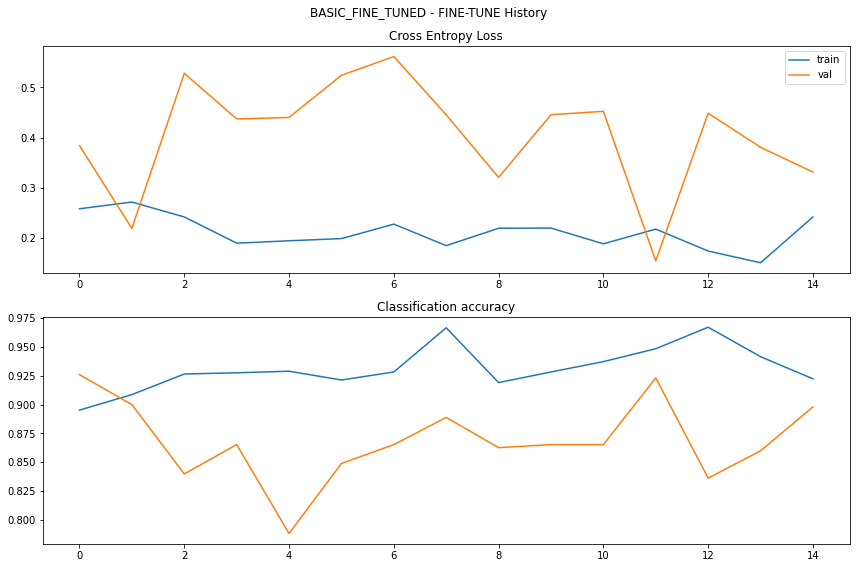

In [28]:
fig = plot_training_history(train_history=ft_train_history, val_history=ft_val_history, model_name=MODEL_NAME, phase_name="FINE-TUNE", out_dir=OUT_DIR)
fig.show()

Clean GPU memory again

In [34]:
model = None

gc.collect()
torch.cuda.empty_cache()
torch.cuda.mem_get_info(device)

(2460129691, 4294836224)

# Fine-tune the fine-tuning with a higher learning rate to escape local minima

In [35]:
best_checkpoint = torch.load(f"{OUT_DIR}/{MODEL_NAME}_ft_best_model.pth")
model = get_model(n_classes=N_CLASSES)
model.load_state_dict(best_checkpoint["model"])
best_checkpoint = None

model.to(device)


print("Loaded best model...")

Loaded best model...


In [36]:
ft_ft_optimizer = optim.Adam(
    params=model.parameters(),
    lr=5e-5,
    betas=(0.9, 0.999),
    weight_decay=5e-4,
    amsgrad=True
)

ft_ft_lr_scheduler = optim.lr_scheduler.ExponentialLR(
    optimizer=ft_ft_optimizer,
    gamma=0.8 # Faster decay as we just want to escape local minima
)

In [37]:
FT_FT_NUM_EPOCHS = 10
model.features.requires_grad_(True) # Unfreeze feature layer for fine-tuning

ft_ft_train_history = {
    "loss": [],
    "accuracy": [],
}

ft_ft_val_history = {
    "loss": [],
    "accuracy": [],
}

ft_ft_best_val_loss = ft_best_val_loss
ft_ft_best_val_accuracy = ft_best_val_accuracy
ft_ft_best_epoch = -1

print(f"Starting {MODEL_NAME} fine-tuning...")

for epoch in range(1, FT_FT_NUM_EPOCHS + 1):
    print(f"Epoch[{epoch}/{FT_FT_NUM_EPOCHS}]")
    (train_target, train_preds, train_probs, _), train_loss = epoch_iter(
        dataloader=train_dataloader,
        model=model,
        loss_fn=loss_fn,
        device=device,
        is_train=True,
        optimizer=ft_ft_optimizer,
        lr_scheduler=ft_ft_lr_scheduler
    )

    train_accuracy = metric_scorer(torch.tensor(np.array(train_probs)), torch.tensor(np.array(train_target))).item()
    print(f"Training loss: {train_loss:.3f}\t Training micro accuracy: {train_accuracy:.3f}")

    (val_target, val_preds, val_probs, _), val_loss = epoch_iter(
        dataloader=val_dataloader,
        model=model,
        loss_fn=loss_fn,
        device=device,
        is_train=False,
    )

    val_accuracy = metric_scorer(torch.tensor(np.array(val_probs)), torch.tensor(np.array(val_target))).item()
    print(f"Validation loss: {val_loss:.3f}\t Validation micro accuracy: {val_accuracy:.3f}")

    # Save best model
    if val_loss < ft_ft_best_val_loss:
        ft_ft_best_val_loss = val_loss
        ft_ft_best_val_accuracy = val_accuracy
        ft_ft_best_epoch = epoch
        save_dict = {"model": model.state_dict(), "optimizer": ft_ft_optimizer.state_dict(), "lr_scheduler": ft_ft_lr_scheduler.state_dict(), "epoch": epoch}
        torch.save(save_dict, f"{OUT_DIR}/{MODEL_NAME}_ft_ft_best_model.pth")

    # Save latest model
    save_dict = {"model": model.state_dict(), "optimizer": ft_ft_optimizer.state_dict(), "lr_scheduler": ft_ft_lr_scheduler.state_dict(), "epoch": epoch}
    torch.save(save_dict, f"{OUT_DIR}/{MODEL_NAME}_ft_ft_latest_model.pth")

    # Save loss and accuracy in history
    ft_ft_train_history["loss"].append(train_loss)
    ft_ft_train_history["accuracy"].append(train_accuracy)

    ft_ft_val_history["loss"].append(val_loss)
    ft_ft_val_history["accuracy"].append(val_accuracy)

    print("----------------------------------------------------------------")

print(
    f"\nFinished fine-fine-tuning..."
    f"\nBest epoch: {ft_ft_best_epoch}\t Validation loss on best epoch: {ft_ft_best_val_loss}\t Accuracy on best epoch: {ft_ft_best_val_accuracy}"
)

Starting BASIC_FINE_TUNED fine-tuning...
Epoch[1/10]


100%|██████████| 29/29 [00:15<00:00,  1.92it/s]


Training loss: 0.251	 Training micro accuracy: 0.908


100%|██████████| 7/7 [00:04<00:00,  1.60it/s]


Validation loss: 0.385	 Validation micro accuracy: 0.920
----------------------------------------------------------------
Epoch[2/10]


100%|██████████| 29/29 [00:16<00:00,  1.80it/s]


Training loss: 0.242	 Training micro accuracy: 0.905


100%|██████████| 7/7 [00:04<00:00,  1.68it/s]


Validation loss: 0.425	 Validation micro accuracy: 0.870
----------------------------------------------------------------
Epoch[3/10]


100%|██████████| 29/29 [00:15<00:00,  1.84it/s]


Training loss: 0.158	 Training micro accuracy: 0.930


100%|██████████| 7/7 [00:04<00:00,  1.52it/s]


Validation loss: 0.300	 Validation micro accuracy: 0.923
----------------------------------------------------------------
Epoch[4/10]


100%|██████████| 29/29 [00:15<00:00,  1.91it/s]


Training loss: 0.133	 Training micro accuracy: 0.966


100%|██████████| 7/7 [00:03<00:00,  1.96it/s]


Validation loss: 0.424	 Validation micro accuracy: 0.882
----------------------------------------------------------------
Epoch[5/10]


100%|██████████| 29/29 [00:14<00:00,  1.98it/s]


Training loss: 0.162	 Training micro accuracy: 0.948


100%|██████████| 7/7 [00:03<00:00,  1.95it/s]


Validation loss: 0.544	 Validation micro accuracy: 0.849
----------------------------------------------------------------
Epoch[6/10]


100%|██████████| 29/29 [00:14<00:00,  2.02it/s]


Training loss: 0.109	 Training micro accuracy: 0.958


100%|██████████| 7/7 [00:03<00:00,  1.90it/s]


Validation loss: 0.325	 Validation micro accuracy: 0.940
----------------------------------------------------------------
Epoch[7/10]


100%|██████████| 29/29 [00:15<00:00,  1.87it/s]


Training loss: 0.087	 Training micro accuracy: 0.976


100%|██████████| 7/7 [00:05<00:00,  1.28it/s]


Validation loss: 0.325	 Validation micro accuracy: 0.941
----------------------------------------------------------------
Epoch[8/10]


100%|██████████| 29/29 [00:15<00:00,  1.84it/s]


Training loss: 0.073	 Training micro accuracy: 0.972


100%|██████████| 7/7 [00:05<00:00,  1.28it/s]


Validation loss: 0.173	 Validation micro accuracy: 0.925
----------------------------------------------------------------
Epoch[9/10]


100%|██████████| 29/29 [00:15<00:00,  1.88it/s]


Training loss: 0.126	 Training micro accuracy: 0.957


100%|██████████| 7/7 [00:05<00:00,  1.38it/s]


Validation loss: 0.446	 Validation micro accuracy: 0.860
----------------------------------------------------------------
Epoch[10/10]


100%|██████████| 29/29 [00:15<00:00,  1.82it/s]


Training loss: 0.099	 Training micro accuracy: 0.990


100%|██████████| 7/7 [00:06<00:00,  1.16it/s]


Validation loss: 0.341	 Validation micro accuracy: 0.906
----------------------------------------------------------------

Finished fine-fine-tuning...
Best epoch: -1	 Validation loss on best epoch: 0.1536447794309684	 Accuracy on best epoch: 0.9230769276618958


C:\Users\telmo\AppData\Local\Temp/ipykernel_6776/2914740446.py:2: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  fig.show()


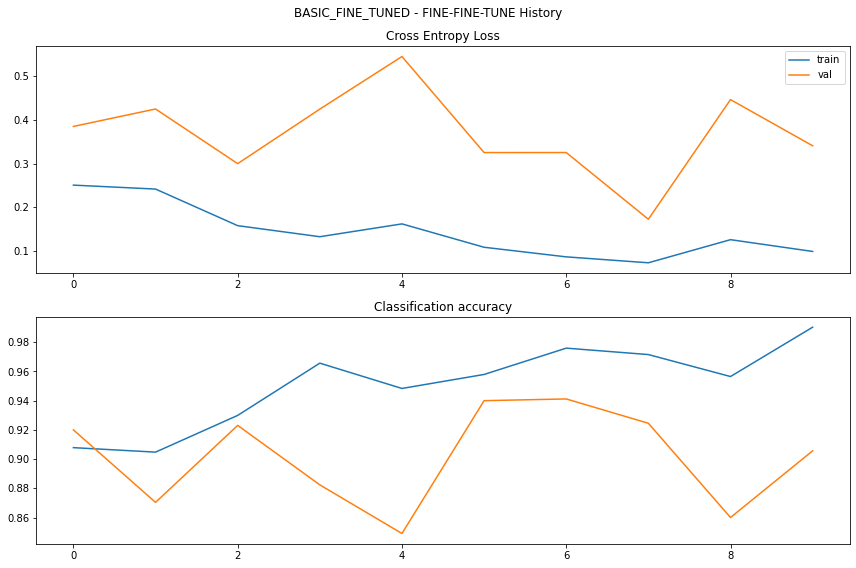

In [38]:
fig = plot_training_history(train_history=ft_ft_train_history, val_history=ft_ft_val_history, model_name=MODEL_NAME, phase_name="FINE-FINE-TUNE", out_dir=OUT_DIR)
fig.show()

In [39]:
model = None

gc.collect()
torch.cuda.empty_cache()
torch.cuda.mem_get_info(device)

(2067962267, 4294836224)

# Test the model

In [40]:
best_checkpoint = torch.load(f"{OUT_DIR}/{MODEL_NAME}_ft_best_model.pth")
model = get_model(n_classes=N_CLASSES)
model.load_state_dict(best_checkpoint["model"])
best_checkpoint = None

model.to(device)


print("Loaded best fine-tuned model...")

Loaded best fine-tuned model...


In [41]:
(test_target, test_preds, test_probs, test_ids), test_loss = epoch_iter(
    dataloader=test_dataloader,
    model=model,
    loss_fn=loss_fn,
    device=device,
    is_train=False,
)

100%|██████████| 264/264 [00:15<00:00, 17.01it/s]


In [42]:
test_metrics = torchmetrics.MetricCollection(
    metrics={
        "micro_accuracy": metric_scorer,
        "macro_accuracy": torchmetrics.Accuracy(
            threshold=0.5,
            num_classes=N_CLASSES,
            average="macro",
        ),
        "weighted_accuracy": torchmetrics.Accuracy(
            threshold=0.5,
            num_classes=N_CLASSES,
            average="weighted",
        ),
        "micro_f1_score": torchmetrics.F1Score(
            threshold=0.5,
            num_classes=N_CLASSES,
            average="micro",
        ),
        "macro_f1_score": torchmetrics.F1Score(
            threshold=0.5,
            num_classes=N_CLASSES,
            average="macro",
        ),
        "weighted_f1_score": torchmetrics.F1Score(
            threshold=0.5,
            num_classes=N_CLASSES,
            average="weighted",
        )
    }
)

test_probs_tensor = torch.tensor(np.array(test_probs))
test_target_tensor = torch.tensor(np.array(test_target))

test_metrics_scores = test_metrics(test_probs_tensor, test_target_tensor)

print(test_metrics_scores)

{'macro_accuracy': tensor(0.8444), 'macro_f1_score': tensor(0.7591), 'micro_accuracy': tensor(0.8333), 'micro_f1_score': tensor(0.8333), 'weighted_accuracy': tensor(0.8333), 'weighted_f1_score': tensor(0.8469)}


In [43]:
from sklearn.metrics import classification_report
print(classification_report(y_true=test_target, y_pred=test_preds, target_names=list(label_encode_map.keys())[1:]))

              precision    recall  f1-score   support

trafficlight       0.49      1.00      0.66        24
  speedlimit       0.98      0.83      0.90       192
   crosswalk       0.59      0.68      0.63        25
        stop       0.83      0.87      0.85        23

    accuracy                           0.83       264
   macro avg       0.72      0.84      0.76       264
weighted avg       0.89      0.83      0.85       264



In [44]:
from PIL import Image
def showErrors(imageIds, y_true, y_pred, limit=None, img_dir = "./"):
    N = limit if limit is not None else len(imageIds)
    N_COLS = 4
    N_ROWS = N // 4 + N % 4
    shown = 0
    fig = plt.figure(figsize=(8*N_COLS, 12*N_ROWS))
    for (imageId, correct, predicted) in zip(imageIds, y_true, y_pred):
        if correct == predicted:
            continue
        image = np.array(Image.open(f"{img_dir}/{imageId}.png").convert("RGB"))
        target_label = f"TRUE: {label_decode_map[correct]}"
        predicted_label = f"PRED: {label_decode_map[predicted]}"

        ax = fig.add_subplot(N_ROWS, N_COLS, shown + 1)
        ax.axis("off")
        ax.text(0, -8, imageId, fontsize=14, color="black")
        ax.text((len(imageId) + 1) * 8, -8, target_label, fontsize=14, color='green') # correct
        ax.text((len(imageId) + len(target_label) + 1) * 8, -8, predicted_label, fontsize=14, color='red')  # predicted
        ax.imshow(image)
        
        shown += 1

        if shown >= N:
            break

    plt.tight_layout()
    plt.show()

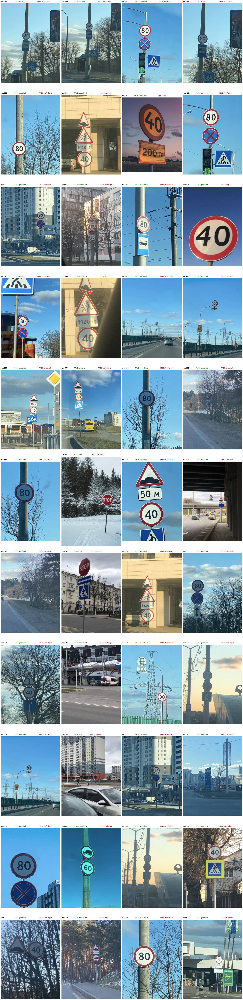

In [45]:
showErrors(test_ids, test_target, test_preds, limit=None, img_dir=IMG_DIR)